In [1]:
import numpy as np
import pandas as pd
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import f1_score
from sklearn import linear_model
import statsmodels.api as sm
from sklearn.cluster import KMeans

#!pip install folium
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import folium
from folium import plugins
from folium.plugins import HeatMap

complaint_df = pd.read_csv('NYPD_Complaint_Data_Historic.csv', delimiter=',', 
                           dtype={'CMPLNT_NUM' : 'int64', 'CMPLNT_FR_DT' : 'string', 'CMPLNT_FR_TM' : 
                                  'string', 'CMPLNT_TO_DT' : 'string', 'CMPLNT_TO_TM' : 'string', 
                                  'ADDR_PCT_CD' : 'string', 'RPT_DT' : 'string', 'KY_CD' : 'int64', 
                                  'OFNS_DESC' : 'string', 'PD_CD' : 'float64', 'PD_DESC' : 'string', 
                                  'CRM_ATPT_CPTD_CD' : 'string', 'LAW_CAT_CD' : 'string', 'BORO_NM' : 'string', 
                                  'LOC_OF_OCCUR_DESC' : 'string', 'PREM_TYP_DESC' : 'string', 
                                  'JURIS_DESC' : 'string', 'JURISDICTION_CODE' : 'float64', 'PARKS_NM' : 'string', 
                                  'HADEVELOPT' : 'string', 'HOUSING_PSA' : 'string', 'X_COORD_CD' : 'float64', 
                                  'Y_COORD_CD' : 'float64', 'SUSP_AGE_GROUP' : 'string', 'SUSP_RACE' : 'string', 
                                  'SUSP_SEX' : 'string', 'TRANSIT_DISTRICT' : 'string', 'Latitude' : 'float64', 
                                  'Longitude' : 'float64', 'Lat_Lon' : 'string', 'PATROL_BORO' : 'string', 
                                  'STATION_NAME' : 'string', 'VIC_AGE_GROUP' : 'string', 'VIC_RACE' : 'string', 
                                  'VIC_SEX' : 'string'})

In [2]:
violent_crime_condition = (complaint_df['PD_DESC'].str.contains('(?i)harassment', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)assault', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)abuse', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)menacing', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)rape', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)strangulation', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)endangering', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)coercion', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)sex', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)homicide', na = False)) |\
    (complaint_df['PD_DESC'].str.contains('(?i)anarchy', na = False)
)

In [3]:
df_crime_complaints = complaint_df[violent_crime_condition].copy()
relevant_premises_condition = (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)street', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)parking', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)bus', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)open areas', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)terminal', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)gas station', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)transit', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)tunnel', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)bridge', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)building', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)cemetary', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)park', na = False)) |\
    (df_crime_complaints['PREM_TYP_DESC'].str.contains('(?i)mailbox', na = False))

In [4]:
df_crime_complaints = df_crime_complaints[relevant_premises_condition]

df = df_crime_complaints['CMPLNT_FR_DT'].str.split('/', expand = True).fillna(np.nan).rename(columns={i: col for i,col in enumerate(['MONTH','DAY','YEAR'])})
df_crime_complaints["YEAR"] = df["YEAR"]
df_crime_complaints.head()
df_crime_complaints["PD_DESC"].unique()

<StringArray>
[                               'ASSAULT 3',
                 'ASSAULT 2,1,UNCLASSIFIED',
               'HARASSMENT,SUBD 1,CIVILIAN',
                         'SEXUAL ABUSE 3,2',
                    'HARASSMENT,SUBD 3,4,5',
                  'AGGRAVATED HARASSMENT 2',
           'PROMOTING A SEXUAL PERFORMANCE',
                    'MENACING,UNCLASSIFIED',
               'CHILD, ENDANGERING WELFARE',
                                   'RAPE 1',
             'ASSAULT POLICE/PEACE OFFICER',
                        'STRANGULATION 1ST',
            'MENACING 1ST DEGREE (VICT NOT',
                  'AGGRAVATED HARASSMENT 1',
    'ASSAULT OTHER PUBLIC SERVICE EMPLOYEE',
                             'SEXUAL ABUSE',
                               'COERCION 2',
                           'RAPE 1,ATTEMPT',
           'VEHICULAR ASSAULT (INTOX DRIVE',
           'MENACING 1ST DEGREE (VICT PEAC',
                   'MENACING,PEACE OFFICER',
            'SEXUAL MISCONDUCT,INTERCOURS

In [5]:
df_crime_complaints = df_crime_complaints[[
    'CMPLNT_NUM',
    'YEAR',
    'PD_DESC',
    'PATROL_BORO',
    'VIC_AGE_GROUP',
    'VIC_RACE',
    'VIC_SEX',
    'Latitude',
    'Longitude'
]]


df = df_crime_complaints.dropna()
df['YEAR'] = df['YEAR'].astype('int')
#df.head()

/var/folders/lf/2prbc3h96p39ng_h9zg9dd740000gn/T/ipykernel_29335/3718547334.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['YEAR'] = df['YEAR'].astype('int')


#### Total Number of Serious Crimes in a Patrol Borough

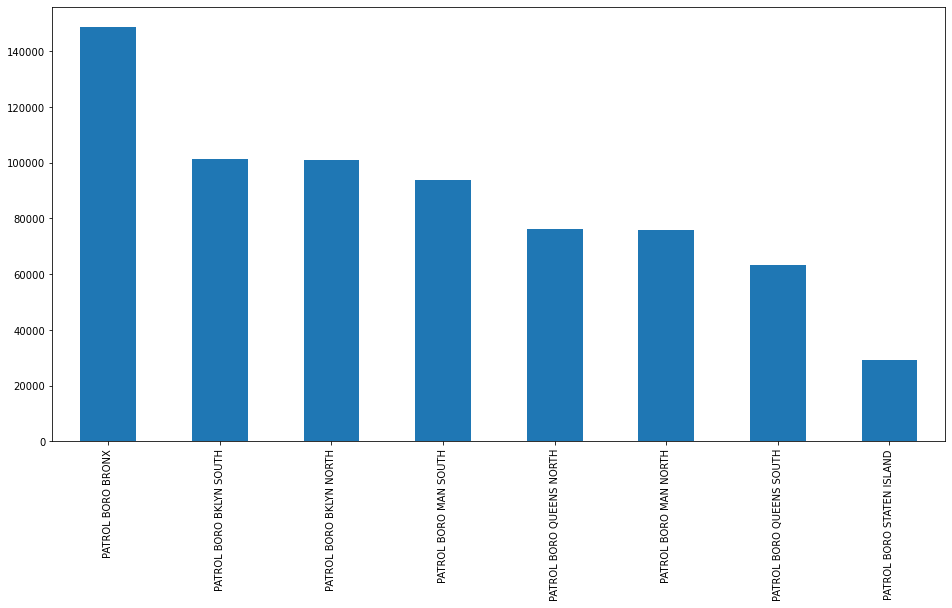

In [6]:
plt.figure(figsize = (16, 8))
df['PATROL_BORO'].value_counts().plot.bar()
plt.show()

#### Total Number of Serious Crimes in a Patrol Borough From 2015 to 2019

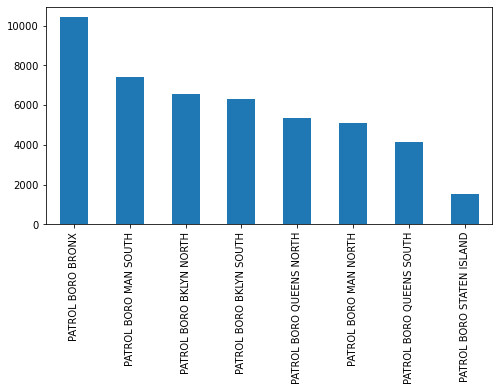

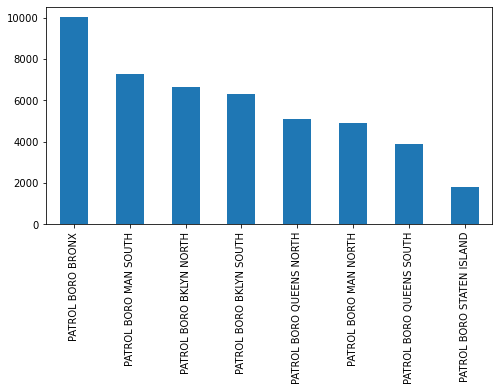

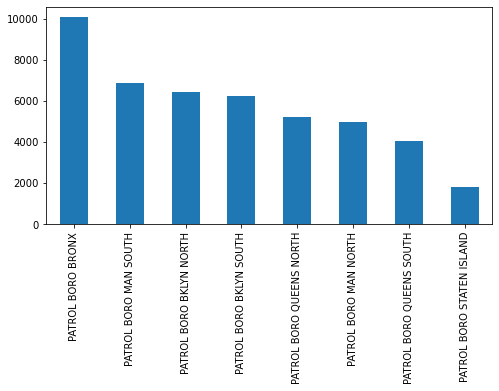

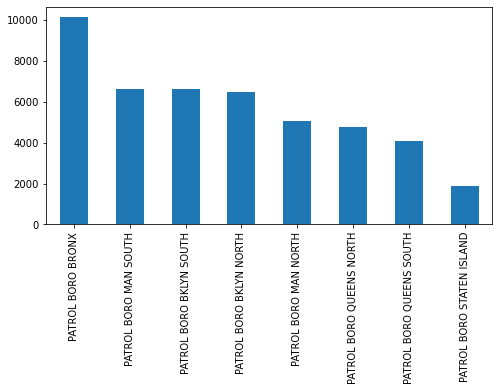

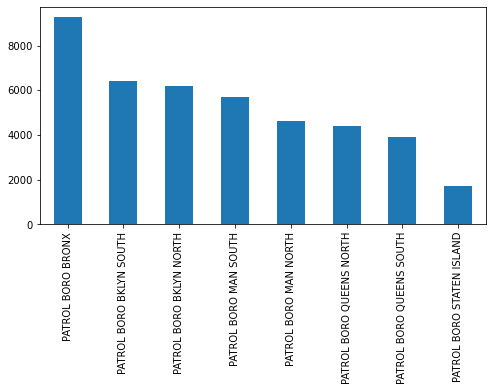

In [7]:
plt.figure(figsize=(8,4))
df['PATROL_BORO'].loc[df['YEAR']==2019].value_counts().plot.bar()
plt.show()

plt.figure(figsize=(8,4))
df['PATROL_BORO'].loc[df['YEAR']==2018].value_counts().plot.bar()
plt.show()

plt.figure(figsize=(8,4))
df['PATROL_BORO'].loc[df['YEAR']==2017].value_counts().plot.bar()
plt.show()

plt.figure(figsize=(8,4))
df['PATROL_BORO'].loc[df['YEAR']==2016].value_counts().plot.bar()
plt.show()

plt.figure(figsize=(8,4))
df['PATROL_BORO'].loc[df['YEAR']==2015].value_counts().plot.bar()
plt.show()

#### Count of Crime Types in NYC

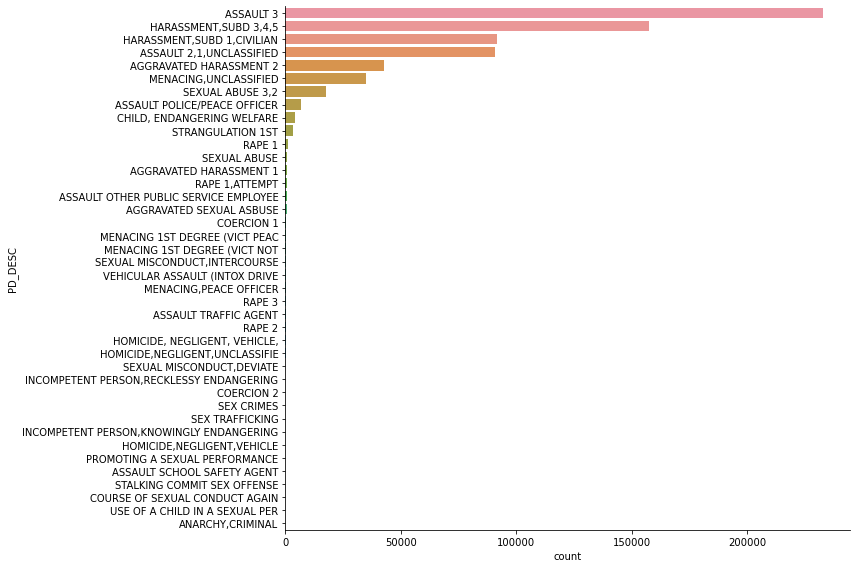

In [8]:
sns.catplot(y= 'PD_DESC', kind = 'count', height = 8, aspect = 1.5, order = df.PD_DESC.value_counts().index, data = df)

#### Visualizing Where Theses Crimes Occur

<AxesSubplot:xlabel='Latitude', ylabel='Longitude'>

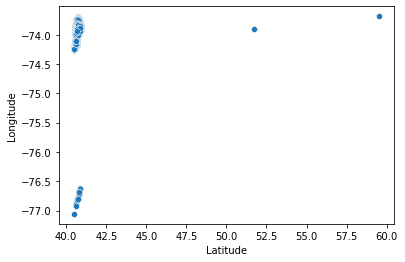

In [9]:
sns.scatterplot(x = 'Latitude', y = 'Longitude', alpha = 1, data = df)

#### Visualizing Where Theses Crimes Occur By Patrol Borough

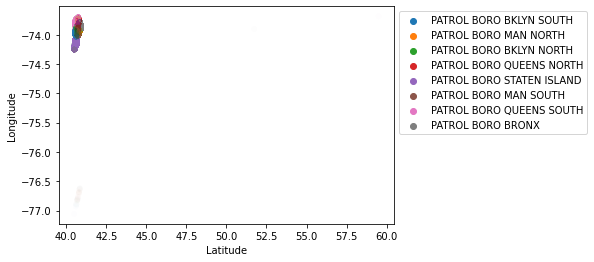

In [10]:
sns.scatterplot(x ='Latitude',y = 'Longitude', hue = 'PATROL_BORO', alpha = 0.01, data = df)
plt.legend(bbox_to_anchor = (1.0, 1), loc = 2)

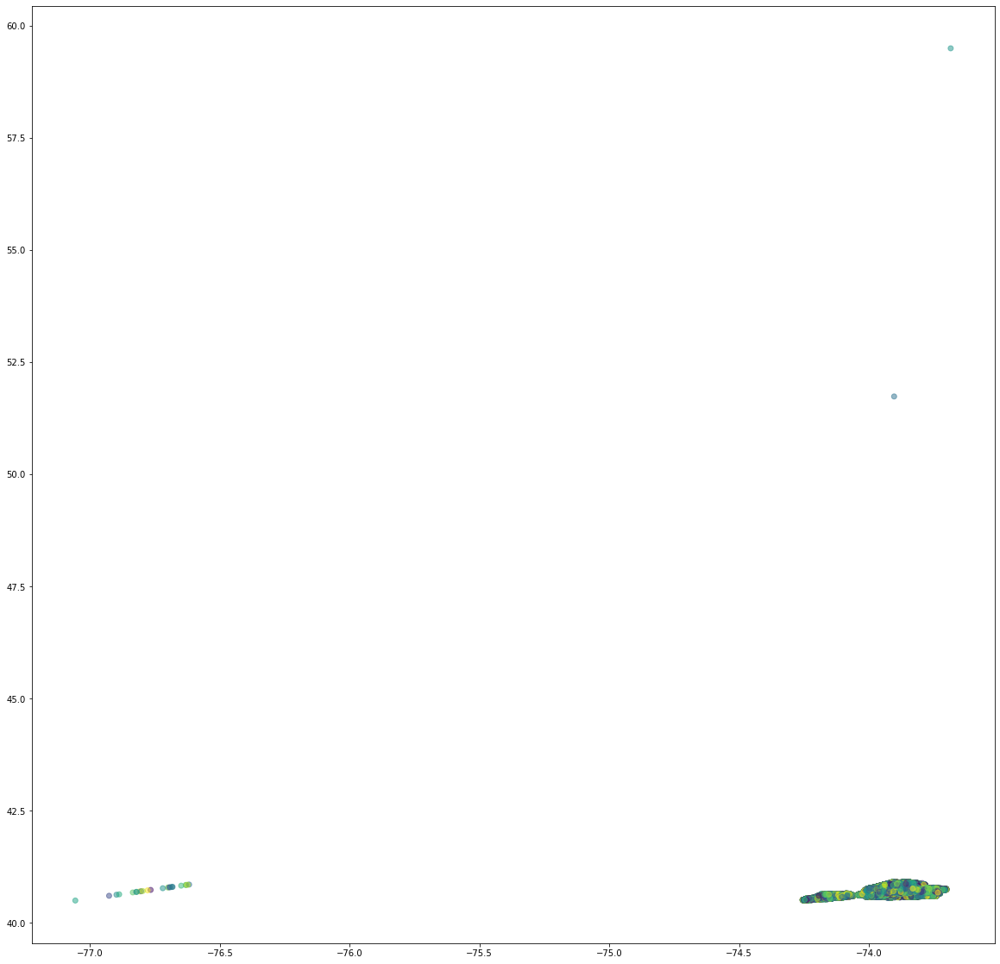

In [11]:
colors = np.random.rand(len(df['Longitude']))

plt.figure(figsize=(20,20))
plt.scatter(df['Longitude'], df['Latitude'],c = colors, alpha=0.5)
plt.show()

In [12]:
NYC = folium.Map([40.730610, -73.935242], zoom_start = 11)
NYC

In [13]:
df['Latitude'] = df['Latitude'].astype(float)
df['Longitude'] = df['Longitude'].astype(float)

heat_df = df[df['YEAR']== '2018']
heat_df = df[['Latitude','Longitude']]
heat_df = [[row['Latitude'], row['Longitude']] for index, row in heat_df.iterrows()]
HeatMap(heat_df).add_to(NYC)
NYC


/var/folders/lf/2prbc3h96p39ng_h9zg9dd740000gn/T/ipykernel_29335/2537248543.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Latitude'] = df['Latitude'].astype(float)
/var/folders/lf/2prbc3h96p39ng_h9zg9dd740000gn/T/ipykernel_29335/2537248543.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Longitude'] = df['Longitude'].astype(float)


#### Modeling

In [14]:
df = df[df['YEAR'] > 2015] #filter for more recent years

location = df[['Latitude','Longitude']]
location = location.dropna()

location = location.loc[(location['Latitude']>40) & (location['Longitude'] < -60)] 

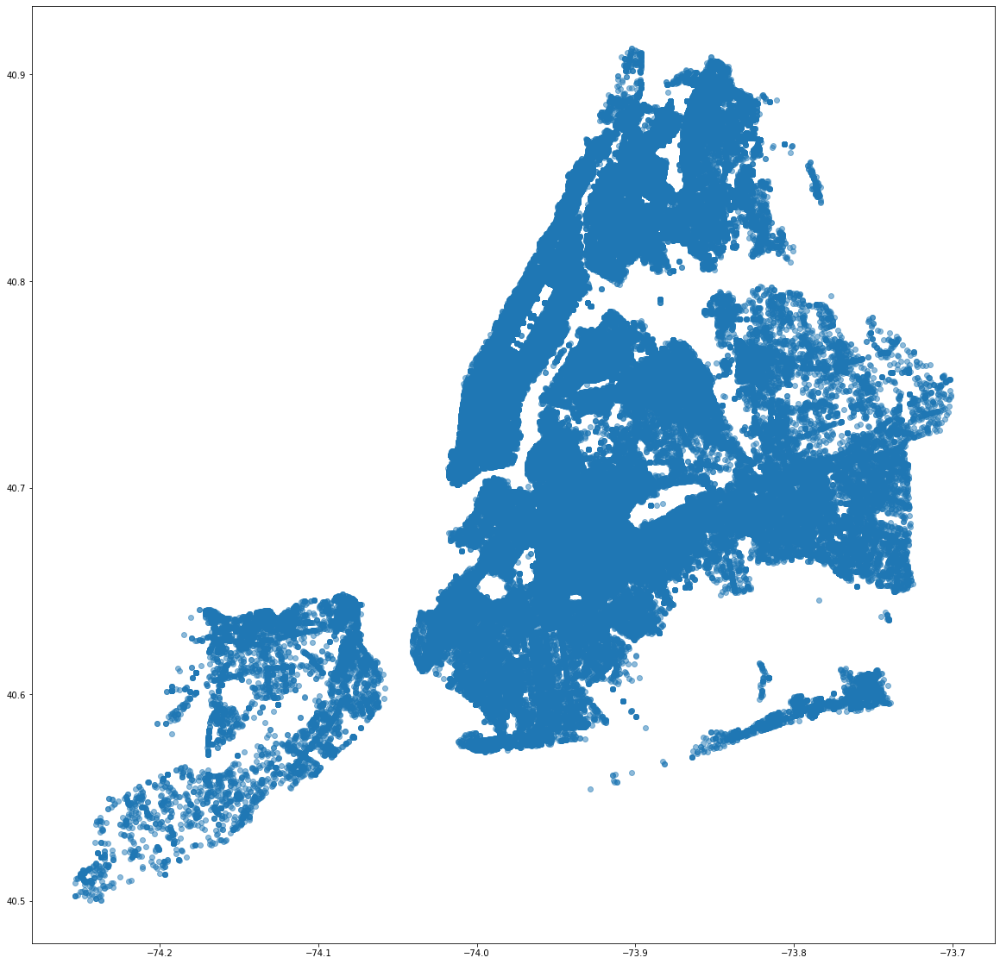

In [15]:
location.isnull().sum()

x = df['Longitude']
y = df['Latitude']

plt.figure(figsize=(20, 20))
plt.scatter(x, y, alpha=0.5)
plt.show()


In [16]:
location = df[['Latitude','Longitude']]
X = location
X = X[~np.isnan(X)]

#### K Means Clustering By Location (Latitude and Longitude) (5 Clusters)

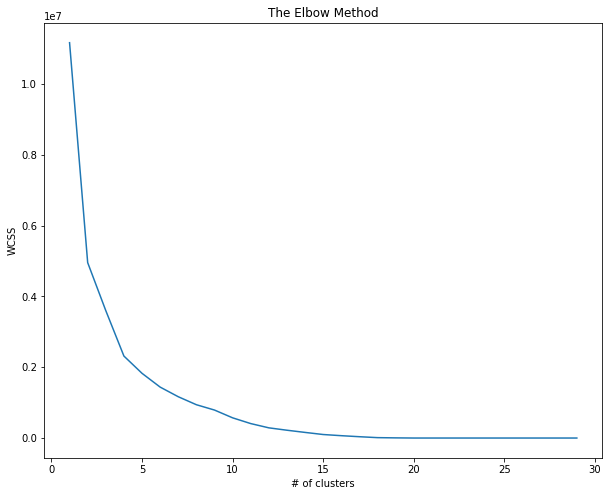

In [21]:
plt.figure(figsize=(10, 8))
wcss = []

for i in range(1, 30):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 30), wcss)
plt.title('The Elbow Method')
plt.xlabel('# of clusters')
plt.ylabel('WCSS')
plt.show()

In [17]:
def kmeans(X, n):
    model = KMeans(n)
    model.fit(X)
    clust_label = model.predict(X)
    cent = model.cluster_centers_
    return (clust_label, cent)

clust_label, cent = kmeans(X, 5)
kmeans = pd.DataFrame(clust_label)
X.insert((X.shape[1]),'kmeans',kmeans)

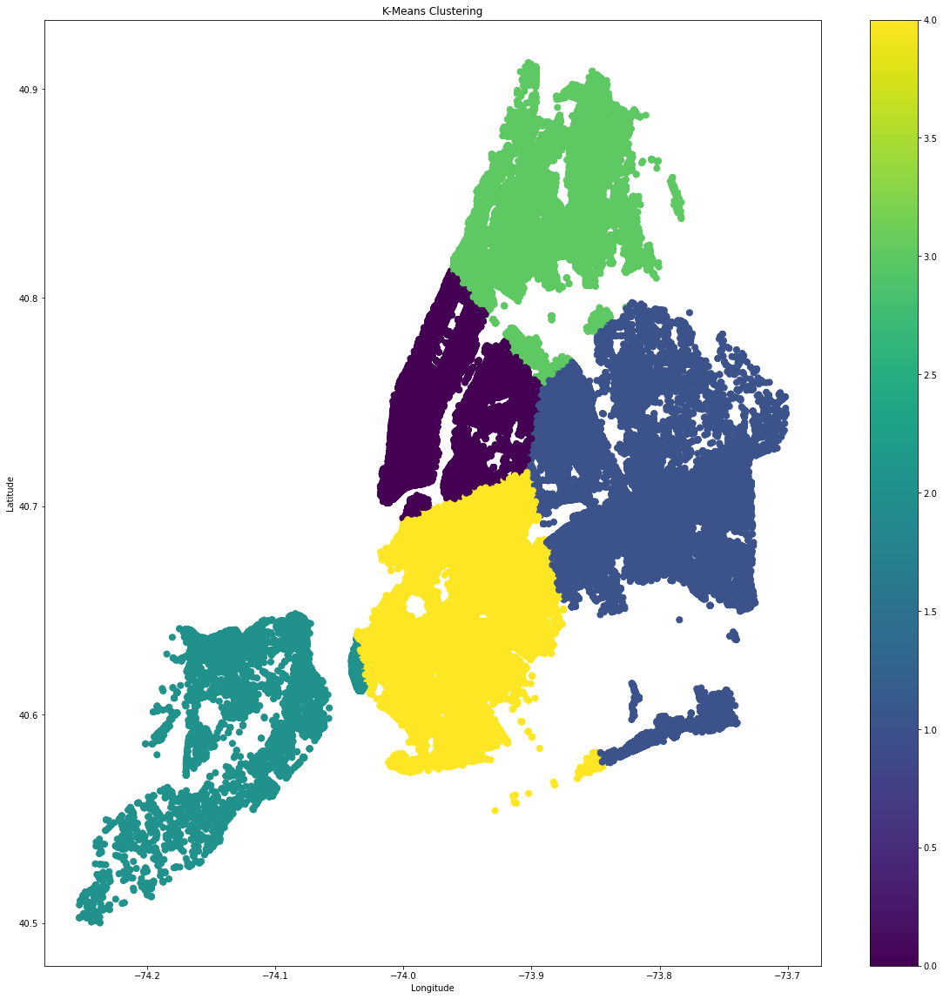

In [18]:
fig = plt.figure(figsize = (20,20))
ax = fig.add_subplot(111)
scatter = ax.scatter(X['Longitude'], X['Latitude'], c = kmeans[0], s = 50)
ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.colorbar(scatter)

#### K Means Clustering By Location (Latitude and Longitude) (10 Clusters)

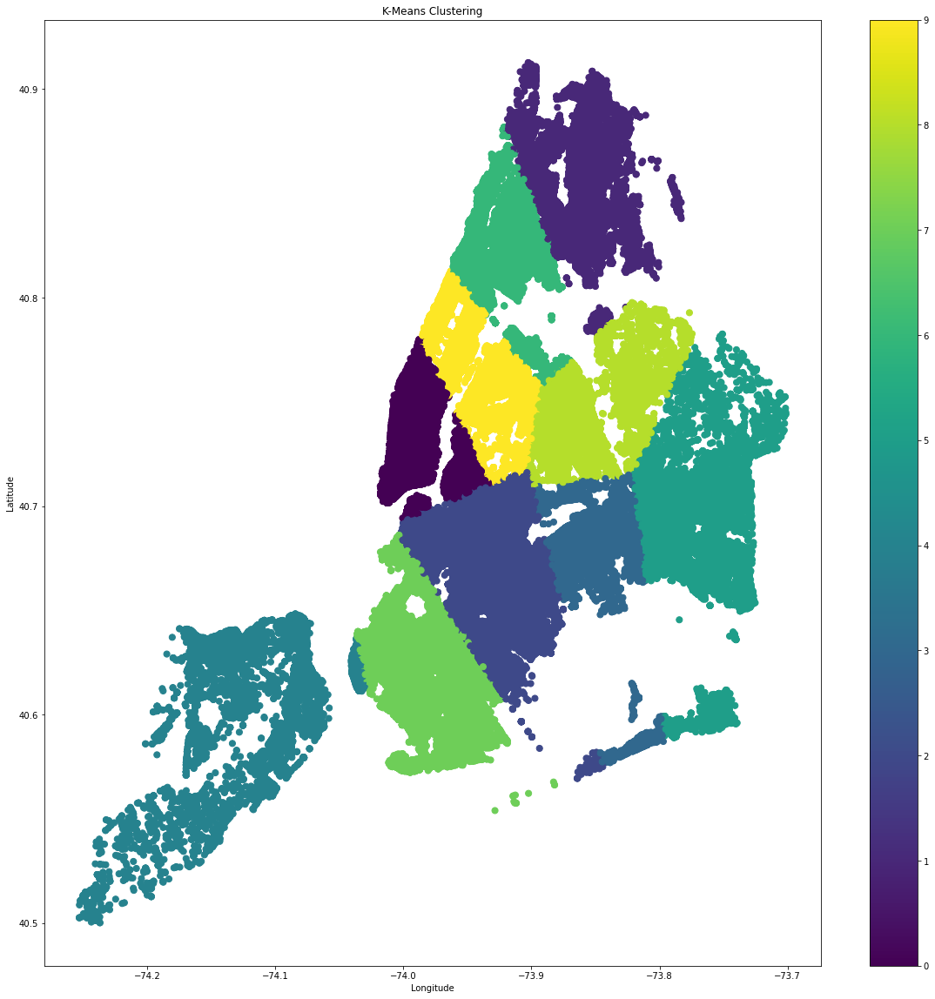

In [19]:
def kmeans(X, n):
    model = KMeans(n)
    model.fit(X)
    clust_label = model.predict(X)
    cent = model.cluster_centers_
    return (clust_label, cent)

clust_label, cent = kmeans(X, 10)
kmeans10 = pd.DataFrame(clust_label)
X.insert((X.shape[1]),'kmeans10',kmeans10)

fig = plt.figure(figsize = (20,20))
ax = fig.add_subplot(111)
scatter = ax.scatter(X['Longitude'], X['Latitude'], c = kmeans10[0], s = 50)
ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.colorbar(scatter)

#### K Means Clustering By Location (Latitude and Longitude) (20 Clusters)

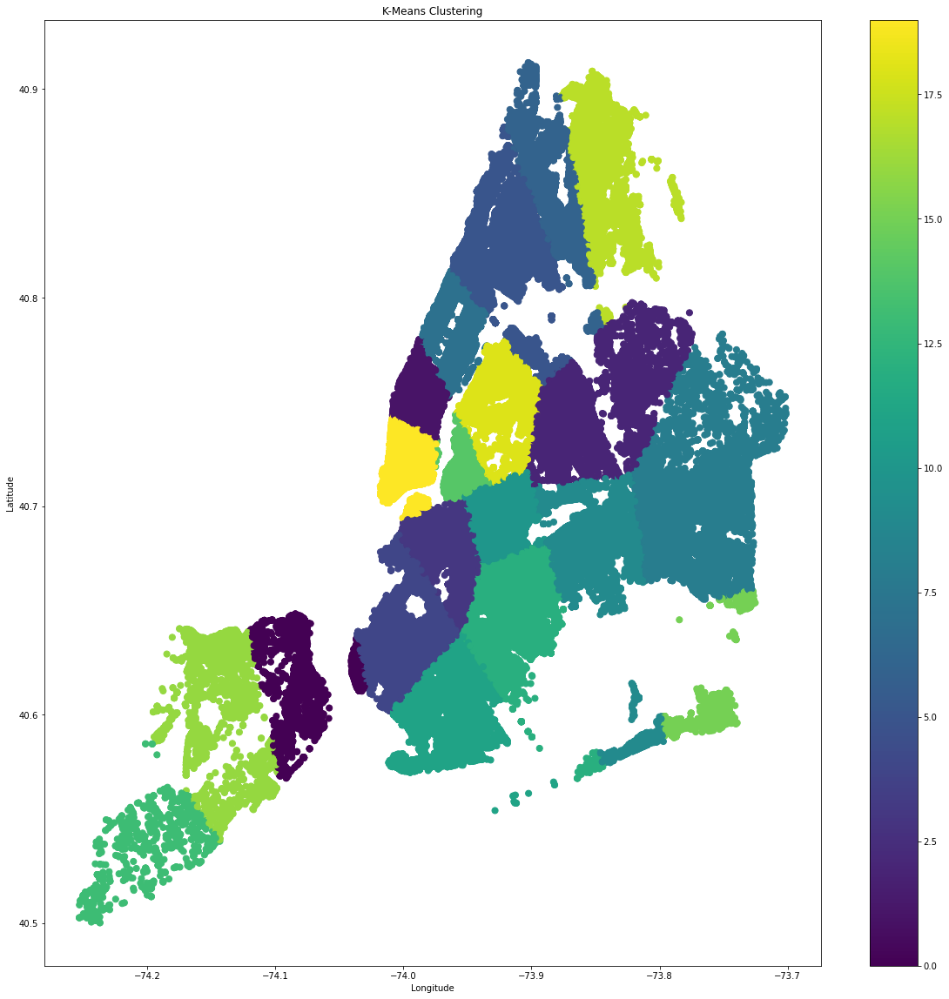

In [20]:
def kmeans(X, n):
    model = KMeans(n)
    model.fit(X)
    clust_label = model.predict(X)
    cent = model.cluster_centers_
    return (clust_label, cent)

clust_label, cent = kmeans(X, 20)
kmeans20 = pd.DataFrame(clust_label)
X.insert((X.shape[1]),'kmeans20',kmeans20)

fig = plt.figure(figsize = (20,20))
ax = fig.add_subplot(111)
scatter = ax.scatter(X['Longitude'], X['Latitude'], c = kmeans20[0], s = 50)
ax.set_title('K-Means Clustering')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.colorbar(scatter)

In [22]:
kmeans = KMeans(n_clusters = 30, init = 'k-means++', random_state = 42)
y_kmeans_pred = kmeans.fit_predict(X)
y_kmeans_pred

array([28, 10,  0, ..., 25, 18, 16], dtype=int32)

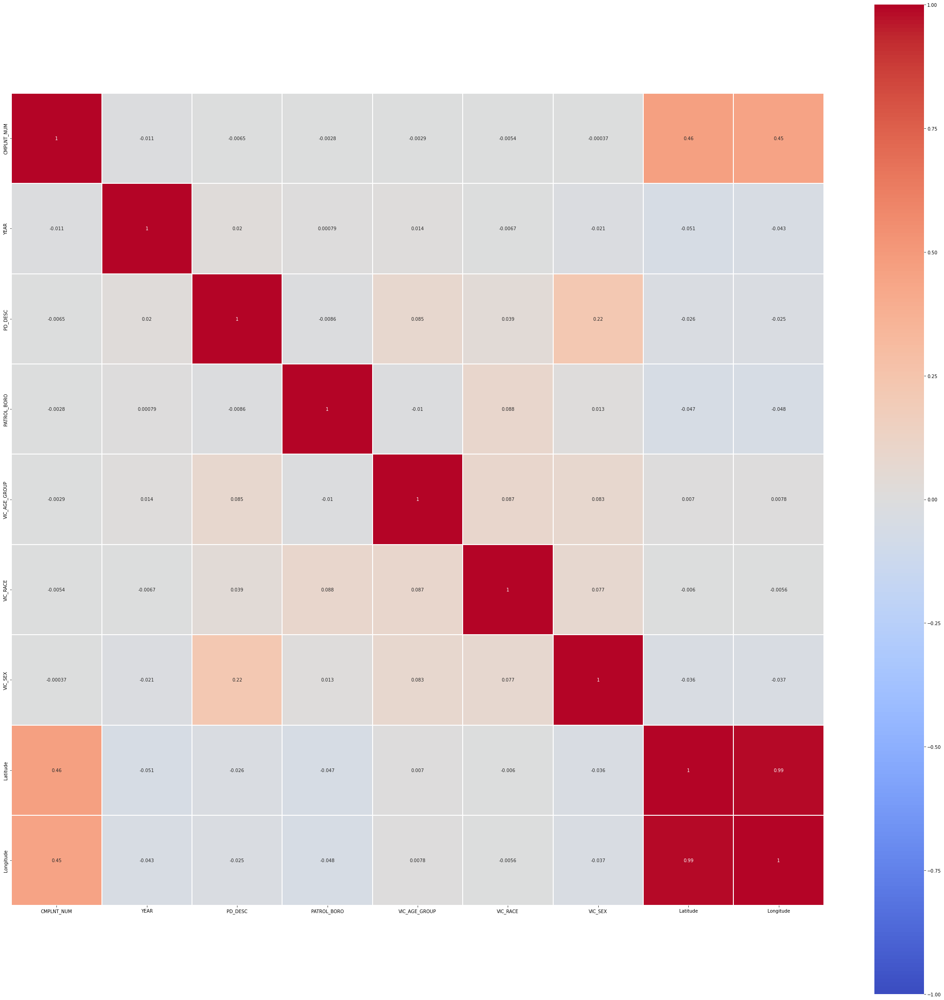

In [23]:
corr = df.apply(lambda x : pd.factorize(x)[0]).corr()
plt.figure(figsize = (40,40))
sns_plot = sns.heatmap(corr, cmap = "coolwarm", linewidth = 2, linecolor = "white", annot=True,vmin=-1, vmax=1, center=0, square=True)